#Table of Contents
* [PacBio k-mer abundance dist](#PacBio-k-mer-abundance-dist)
	* [k = 13](#k-=-13)
		* [True 13-mer abundance dist](#True-13-mer-abundance-dist)
	* [k = 19](#k-=-19)
		* [True 19-mer abundance dist](#True-19-mer-abundance-dist)
	* [k = 25](#k-=-25)
		* [True 25-mer abundance dist](#True-25-mer-abundance-dist)
	* [k = 31](#k-=-31)
		* [True 31-mer abundance dist](#True-31-mer-abundance-dist)


# PacBio k-mer abundance dist


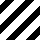
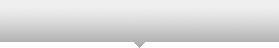
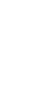
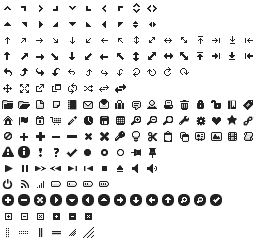
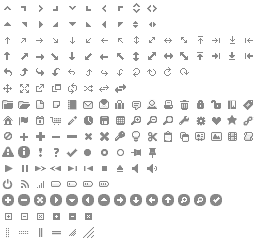
...
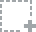
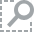
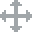
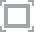
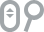

In [106]:
%matplotlib inline

import pandas as pd
import numpy as np

import matplotlib.pyplot as plt
import seaborn as sns

from bokeh.plotting import show, output_notebook, figure
from bokeh.models import Range1d
output_notebook()

In [107]:
from screed.fastq import fastq_iter
import gzip

In [133]:
def plot_dist(dist_file, xmin=0, ymin=0, xmax=None, ymax=None):
    x = np.loadtxt(dist_file)

    if xmin:
        min_p = np.argwhere(x[:, 0] == xmin)
        ymax = np.max(x[min_p:, 1])
    
    plt.figure(figsize=(12, 8))
    plt.plot(x[:, 0], x[:, 1])
    plt.xlabel('k-mer abundance')
    plt.ylabel('# of k-mers with that abundance')
    plt.title('k-mer spectrum: %s' % dist_file)
    plt.axis(xmin=xmin, ymin=ymin, xmax=xmax, ymax=ymax)
    plt.show()

    p = figure(plot_height=600, plot_width=800,
               title='k-mer spectrum: %s' % dist_file,
               y_axis_label='# of k-mers with that abundance',
               x_axis_label='k-mer abundance')
    p.scatter(x[:, 0], x[:, 1], fill_color='white')
    p.line(x[:, 0], x[:, 1])
#    if xmax is None:
#        xmax = np.max(x[:, 0])

#
#    if ymax is None:
#        ymax = np.max(x[:, 1])
#    p.x_range = Range1d(xmin, xmax)
#    p.y_range = Range1d(ymin, ymax)
    show(p)

## k = 13

In [134]:
!cd ../2015-khmer-wok2-vc && make -Bn pacbio.k13.dist

/usr/bin/time -v -o timing/pacbio.k13.unique.`date +%Y%m%d.%H%M` -- \
    env OMP_NUM_THREADS=16 ../khmer/sandbox/unique-kmers.py -R pacbio.k13.unique -e 0.01 -k 13 /mnt/research/ged/irberlui/biodata/Chicken_Pacbio_Data_Assembly/Chicken_filtered_pacbio_subreads_60X.fasta
/usr/bin/time -v -o timing/pacbio.k13.kh.`date +%Y%m%d.%H%M` load-into-counting.py -k 13 -N 6 -x 56175528 pacbio.k13.kh /mnt/research/ged/irberlui/biodata/Chicken_Pacbio_Data_Assembly/Chicken_filtered_pacbio_subreads_60X.fasta
/usr/bin/time -v -o timing/pacbio.k13.dist.`date +%Y%m%d.%H%M` abundance-dist.py -s pacbio.k13.kh /mnt/research/ged/irberlui/biodata/Chicken_Pacbio_Data_Assembly/Chicken_filtered_pacbio_subreads_60X.fasta pacbio.k13.dist


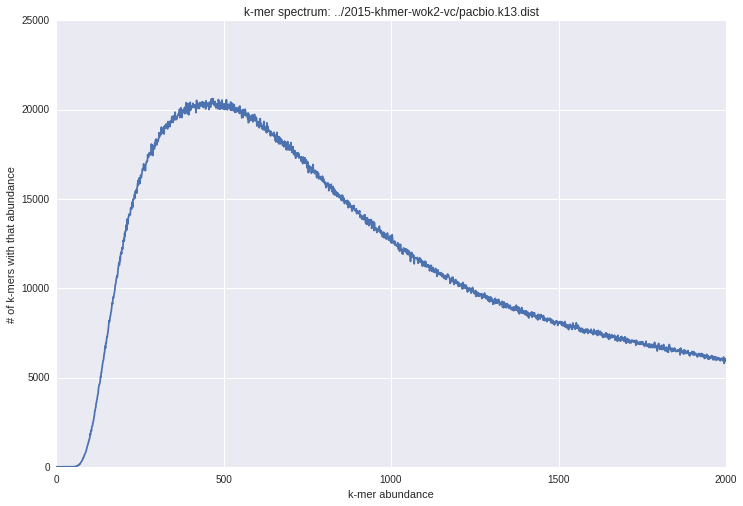

In [135]:
plot_dist("../2015-khmer-wok2-vc/pacbio.k13.dist", xmax=2000)

### True 13-mer abundance dist

In [159]:
!cd ../2015-khmer-wok2-vc && make -Bn pacbio.k13.galGal4.dist

/usr/bin/time -v -o timing/pacbio.k13.unique.`date +%Y%m%d.%H%M` -- \
    env OMP_NUM_THREADS=16 ../khmer/sandbox/unique-kmers.py -R pacbio.k13.unique -e 0.01 -k 13 /mnt/research/ged/irberlui/biodata/Chicken_Pacbio_Data_Assembly/Chicken_filtered_pacbio_subreads_60X.fasta
/usr/bin/time -v -o timing/pacbio.k13.kh.`date +%Y%m%d.%H%M` load-into-counting.py -k 13 -N 6 -x 56175528 pacbio.k13.kh /mnt/research/ged/irberlui/biodata/Chicken_Pacbio_Data_Assembly/Chicken_filtered_pacbio_subreads_60X.fasta
wget -SNc ftp://hgdownload.cse.ucsc.edu/goldenPath/galGal4/bigZips/galGal4.fa.gz
python fix_reference.py galGal4.fa.gz galGal4.fixed.fa.gz
/usr/bin/time -v -o timing/pacbio.k13.galGal4.dist.`date +%Y%m%d.%H%M` abundance-dist.py -s pacbio.k13.kh galGal4.fixed.fa.gz pacbio.k13.galGal4.dist


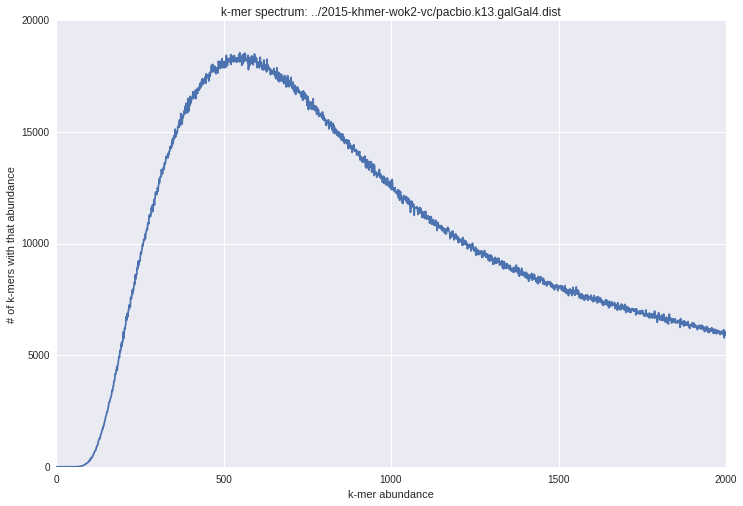

In [161]:
plot_dist("../2015-khmer-wok2-vc/pacbio.k13.galGal4.dist", xmax=2000)

## k = 19

In [136]:
!cd ../2015-khmer-wok2-vc && make -Bn pacbio.k19.dist

/usr/bin/time -v -o timing/pacbio.k19.unique.`date +%Y%m%d.%H%M` -- \
    env OMP_NUM_THREADS=16 ../khmer/sandbox/unique-kmers.py -R pacbio.k19.unique -e 0.01 -k 19 /mnt/research/ged/irberlui/biodata/Chicken_Pacbio_Data_Assembly/Chicken_filtered_pacbio_subreads_60X.fasta
/usr/bin/time -v -o timing/pacbio.k19.kh.`date +%Y%m%d.%H%M` load-into-counting.py -k 19 -N 6 -x 60401007714 pacbio.k19.kh /mnt/research/ged/irberlui/biodata/Chicken_Pacbio_Data_Assembly/Chicken_filtered_pacbio_subreads_60X.fasta
/usr/bin/time -v -o timing/pacbio.k19.dist.`date +%Y%m%d.%H%M` abundance-dist.py -s pacbio.k19.kh /mnt/research/ged/irberlui/biodata/Chicken_Pacbio_Data_Assembly/Chicken_filtered_pacbio_subreads_60X.fasta pacbio.k19.dist


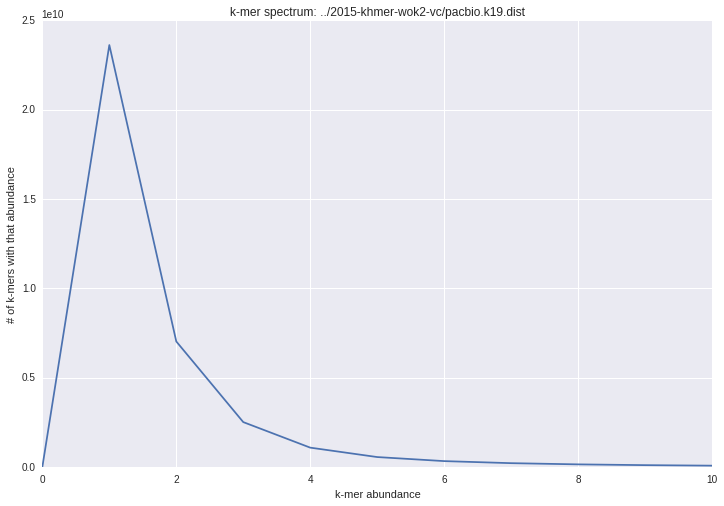

In [137]:
plot_dist("../2015-khmer-wok2-vc/pacbio.k19.dist", xmax=10)

### True 19-mer abundance dist

In [141]:
!cd ../2015-khmer-wok2-vc && make -Bn pacbio.k19.galGal4.dist

/usr/bin/time -v -o timing/pacbio.k19.unique.`date +%Y%m%d.%H%M` -- \
    env OMP_NUM_THREADS=16 ../khmer/sandbox/unique-kmers.py -R pacbio.k19.unique -e 0.01 -k 19 /mnt/research/ged/irberlui/biodata/Chicken_Pacbio_Data_Assembly/Chicken_filtered_pacbio_subreads_60X.fasta
/usr/bin/time -v -o timing/pacbio.k19.kh.`date +%Y%m%d.%H%M` load-into-counting.py -k 19 -N 6 -x 60401007714 pacbio.k19.kh /mnt/research/ged/irberlui/biodata/Chicken_Pacbio_Data_Assembly/Chicken_filtered_pacbio_subreads_60X.fasta
wget -SNc ftp://hgdownload.cse.ucsc.edu/goldenPath/galGal4/bigZips/galGal4.fa.gz
python fix_reference.py galGal4.fa.gz galGal4.fixed.fa.gz
/usr/bin/time -v -o timing/pacbio.k19.galGal4.dist.`date +%Y%m%d.%H%M` abundance-dist.py -s pacbio.k19.kh galGal4.fixed.fa.gz pacbio.k19.galGal4.dist


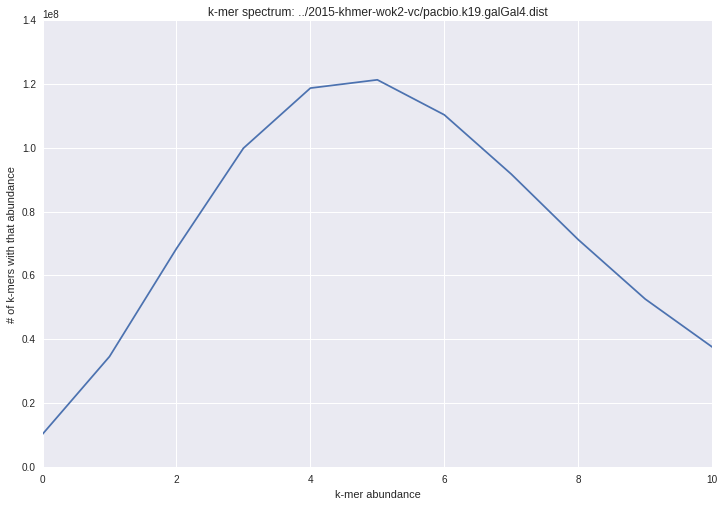

In [145]:
plot_dist("../2015-khmer-wok2-vc/pacbio.k19.galGal4.dist", xmax=10)

## k = 25

In [138]:
!cd ../2015-khmer-wok2-vc && make -Bn pacbio.k25.dist

/usr/bin/time -v -o timing/pacbio.k25.unique.`date +%Y%m%d.%H%M` -- \
    env OMP_NUM_THREADS=16 ../khmer/sandbox/unique-kmers.py -R pacbio.k25.unique -e 0.01 -k 25 /mnt/research/ged/irberlui/biodata/Chicken_Pacbio_Data_Assembly/Chicken_filtered_pacbio_subreads_60X.fasta
/usr/bin/time -v -o timing/pacbio.k25.kh.`date +%Y%m%d.%H%M` load-into-counting.py -k 25 -N 6 -x 98748807333 pacbio.k25.kh /mnt/research/ged/irberlui/biodata/Chicken_Pacbio_Data_Assembly/Chicken_filtered_pacbio_subreads_60X.fasta
/usr/bin/time -v -o timing/pacbio.k25.dist.`date +%Y%m%d.%H%M` abundance-dist.py -s pacbio.k25.kh /mnt/research/ged/irberlui/biodata/Chicken_Pacbio_Data_Assembly/Chicken_filtered_pacbio_subreads_60X.fasta pacbio.k25.dist


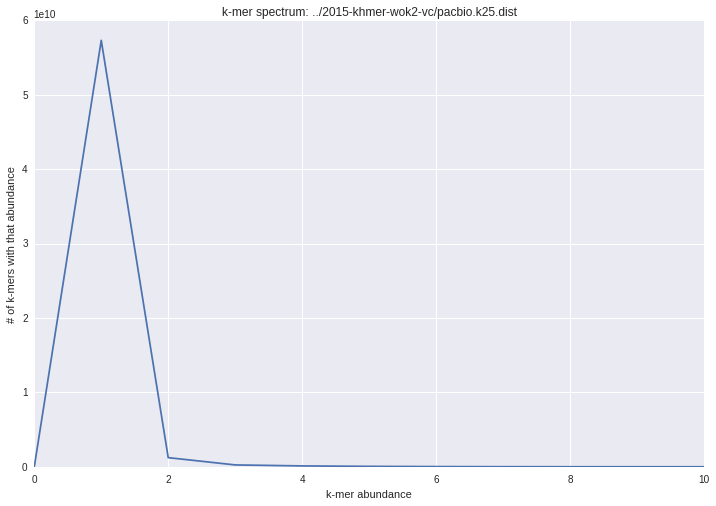

In [149]:
plot_dist("../2015-khmer-wok2-vc/pacbio.k25.dist", xmax=10)

### True 25-mer abundance dist

In [147]:
!cd ../2015-khmer-wok2-vc && make -Bn pacbio.k25.galGal4.dist

/usr/bin/time -v -o timing/pacbio.k25.unique.`date +%Y%m%d.%H%M` -- \
    env OMP_NUM_THREADS=16 ../khmer/sandbox/unique-kmers.py -R pacbio.k25.unique -e 0.01 -k 25 /mnt/research/ged/irberlui/biodata/Chicken_Pacbio_Data_Assembly/Chicken_filtered_pacbio_subreads_60X.fasta
/usr/bin/time -v -o timing/pacbio.k25.kh.`date +%Y%m%d.%H%M` load-into-counting.py -k 25 -N 6 -x 98748807333 pacbio.k25.kh /mnt/research/ged/irberlui/biodata/Chicken_Pacbio_Data_Assembly/Chicken_filtered_pacbio_subreads_60X.fasta
wget -SNc ftp://hgdownload.cse.ucsc.edu/goldenPath/galGal4/bigZips/galGal4.fa.gz
python fix_reference.py galGal4.fa.gz galGal4.fixed.fa.gz
/usr/bin/time -v -o timing/pacbio.k25.galGal4.dist.`date +%Y%m%d.%H%M` abundance-dist.py -s pacbio.k25.kh galGal4.fixed.fa.gz pacbio.k25.galGal4.dist


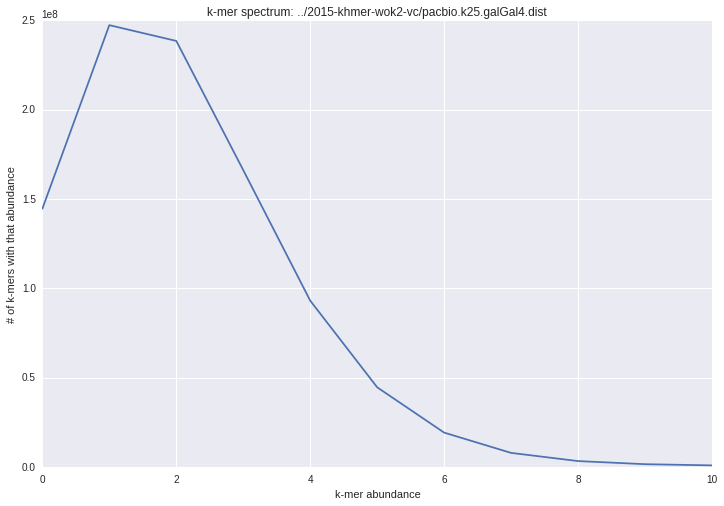

In [150]:
plot_dist("../2015-khmer-wok2-vc/pacbio.k25.galGal4.dist", xmax=10)

## k = 31

In [ ]:
!cd ../2015-khmer-wok2-vc && make -Bn pacbio.k31.dist

In [ ]:
plot_dist("../2015-khmer-wok2-vc/pacbio.k31.dist")

### True 31-mer abundance dist

In [151]:
!cd ../2015-khmer-wok2-vc && make -Bn pacbio.k31.galGal4.dist

/usr/bin/time -v -o timing/pacbio.k31.unique.`date +%Y%m%d.%H%M` -- \
    env OMP_NUM_THREADS=16 ../khmer/sandbox/unique-kmers.py -R pacbio.k31.unique -e 0.01 -k 31 /mnt/research/ged/irberlui/biodata/Chicken_Pacbio_Data_Assembly/Chicken_filtered_pacbio_subreads_60X.fasta
/usr/bin/time -v -o timing/pacbio.k31.kh.`date +%Y%m%d.%H%M` load-into-counting.py -k 31 -N 6 -x 102732016737 pacbio.k31.kh /mnt/research/ged/irberlui/biodata/Chicken_Pacbio_Data_Assembly/Chicken_filtered_pacbio_subreads_60X.fasta
wget -SNc ftp://hgdownload.cse.ucsc.edu/goldenPath/galGal4/bigZips/galGal4.fa.gz
python fix_reference.py galGal4.fa.gz galGal4.fixed.fa.gz
/usr/bin/time -v -o timing/pacbio.k31.galGal4.dist.`date +%Y%m%d.%H%M` abundance-dist.py -s pacbio.k31.kh galGal4.fixed.fa.gz pacbio.k31.galGal4.dist


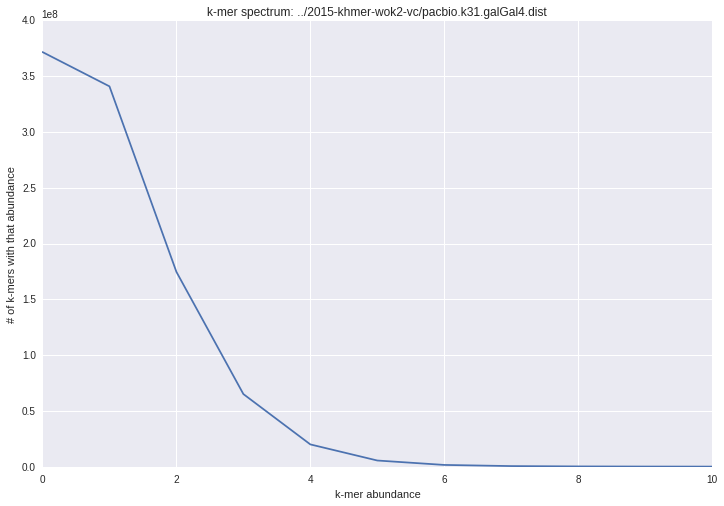

In [154]:
plot_dist("../2015-khmer-wok2-vc/pacbio.k31.galGal4.dist", xmax=10)